In [1]:
from itertools import combinations_with_replacement, product
from pathlib import Path

import matplotlib
import matplotlib.pyplot as plt
import msprime
import numpy as np
import pandas as pd
import pyslim
import tskit

In [2]:
TS = Path("~/simulation-outputs/spatial-runs/spatial_0.4.trees").expanduser()
MU = 1e-8
SEED = 23

In [3]:
ts = tskit.load(TS)

In [4]:
gentimes = np.array(
    [
        g
        for g in ts.metadata["SLiM"]["user_metadata"]["generation_times"]
        if g is not None
    ]
)

In [5]:
gentimes = np.array(
    ts.metadata["SLiM"]["user_metadata"]["generation_times"], dtype=np.float64
)
gentimes = gentimes[~np.isnan(gentimes)]
assert len(gentimes) == ts.metadata["SLiM"]["tick"]

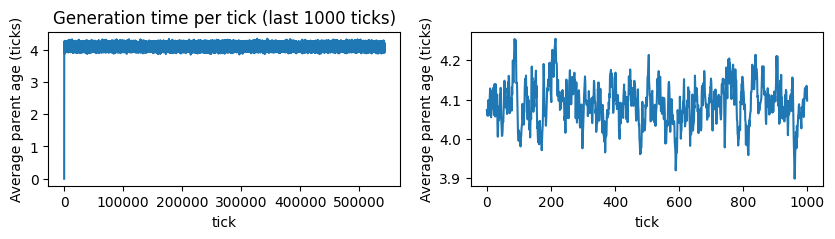

In [6]:
plt.subplots(1, 2, figsize=(10, 2))
plt.gcf().axes[0].plot(gentimes)
plt.gcf().axes[0].set_title("Generation time per tick")
[ax.set_ylabel("Average parent age (ticks)") for ax in plt.gcf().axes]
[ax.set_xlabel("tick") for ax in plt.gcf().axes]
plt.gcf().axes[1].plot(gentimes[-1000:])
plt.gcf().axes[0].set_title("Generation time per tick (last 1000 ticks)");

In [7]:
GT = gentimes[-100000:].mean()
print(f"Estimated generation time: {GT}")

Estimated generation time: 4.08587881805499


In [8]:
ts = msprime.sim_mutations(ts, rate=MU / GT, random_seed=SEED)

In [9]:
ts

In [10]:
MODEL_PARAMS = {
    k: v[0] for k, v in ts.metadata["SLiM"]["user_metadata"]["params"][0].items()
}
MODEL_PARAMS

{'G': 100000000,
 'IND_RECORD_FREQ': 200,
 'IND_RECORD_LAG': 10,
 'IND_RECORD_LIM': 20,
 'K': 5,
 'L': 4,
 'MU': 0,
 'OUTPATH': './spatial_0.4.trees',
 'R': 1e-08,
 'SD': 0.4,
 'SEED': 23,
 'SI': 0.4,
 'SIM_END': 2000000,
 'SM': 0.4,
 'W': 25.0}

In [11]:
if (np.array([t.num_roots for t in ts.trees()]) == 1).all():
    print("all trees have coalesced")

all trees have coalesced


In [12]:
SAMPLING_TIMES = np.array(
    ts.metadata["SLiM"]["user_metadata"]["sampling_times"], dtype=int
)
SAMPLING_TIMES

array([527121, 527921, 528721, 529521, 530321, 531121, 531921, 532721,
       533521, 534321, 535121, 535921, 536721, 537521, 538321, 539121,
       539921, 540721, 541521, 542321])

In [13]:
REL_SAMPLING_TIMES = SAMPLING_TIMES - SAMPLING_TIMES[0]

In [14]:
def inds_at_times(ts):
    assert (
        ts.individuals_time - ts.individuals_time.astype(int)
    ).sum() == 0, "assumptions violated"
    times, counts = np.unique(ts.individuals_time.astype(int), return_counts=True)
    return pd.DataFrame(dict(time=times, n_individuals=counts)).set_index("time")

In [16]:
print("Individuals born at sampling time")
inds_at_times(ts).loc[REL_SAMPLING_TIMES, :]

Individuals born at sampling time


,n_individuals
time,
0,1104
800,1080
1600,1158
2400,1081
3200,1062
4000,1111
4800,1148
5600,1146
6400,1081


In [15]:
def get_individuals_at_time_in_space(ts, t, space_width, sample_width):
    W = space_width
    w = sample_width
    alive = pyslim.individuals_alive_at(ts, t)
    locs = ts.individuals_location[alive, :]
    groups = {
        "all": alive,
        "topleft": alive[(locs[:, 0] < w) & (locs[:, 1] < w)],
        "topright": alive[(locs[:, 0] < w) & (locs[:, 1] > W - w)],
        "bottomleft": alive[(locs[:, 0] > W - w) & (locs[:, 1] < w)],
        "bottomright": alive[(locs[:, 0] > W - w) & (locs[:, 1] > W - w)],
        "center": alive[
            (np.abs(locs[:, 0] - W / 2) < w / 2) & (np.abs(locs[:, 1] - W / 2) < w / 2)
        ],
    }
    return groups


def sample_individuals(samples, n, seed):
    rng = np.random.RandomState(seed)
    return {
        k: rng.choice(v, size=n, replace=False)
        for k, v in samples.items()
        if k != "all"
    }

In [18]:
spatial_samples = [
    get_individuals_at_time_in_space(ts, t, MODEL_PARAMS["W"], 6)
    for t in REL_SAMPLING_TIMES
]

In [19]:
pd.DataFrame(
    {
        t: {k: len(v) for k, v in spatial_samples[i].items()}
        for i, t in enumerate(REL_SAMPLING_TIMES)
    }
)

,0,800,1600,2400,3200,4000,4800,5600,6400,7200,8000,8800,9600,10400,11200,12000,12800,13600,14400,15200
all,4474,4397,4511,4432,4478,4376,4578,4506,4509,4497,4582,4493,4511,4551,4539,4490,4450,4417,4517,4596
topleft,242,255,284,248,264,235,234,273,271,246,289,260,246,234,305,270,233,282,247,282
topright,257,265,282,253,234,265,265,279,271,260,234,268,258,263,274,278,256,267,276,270
bottomleft,242,243,292,260,284,260,247,250,244,261,258,265,253,261,233,251,297,267,247,266
bottomright,236,268,214,238,258,254,254,242,256,285,256,264,230,271,276,234,254,251,232,273
center,241,234,257,232,256,261,252,286,257,253,285,283,257,243,252,261,234,248,248,253


In [20]:
sampled_spatial_samples = [sample_individuals(s, 50, SEED) for s in spatial_samples]

In [21]:
pd.DataFrame(
    {
        t: {k: len(v) for k, v in sampled_spatial_samples[i].items()}
        for i, t in enumerate(REL_SAMPLING_TIMES)
    }
)

,0,800,1600,2400,3200,4000,4800,5600,6400,7200,8000,8800,9600,10400,11200,12000,12800,13600,14400,15200
topleft,50,50,50,50,50,50,50,50,50,50,50,50,50,50,50,50,50,50,50,50
topright,50,50,50,50,50,50,50,50,50,50,50,50,50,50,50,50,50,50,50,50
bottomleft,50,50,50,50,50,50,50,50,50,50,50,50,50,50,50,50,50,50,50,50
bottomright,50,50,50,50,50,50,50,50,50,50,50,50,50,50,50,50,50,50,50,50
center,50,50,50,50,50,50,50,50,50,50,50,50,50,50,50,50,50,50,50,50


In [25]:
def plot_locations(ts, groups, all_samples, ax=None, sampled_s=20, all_s=7):
    if ax is None:
        fig, ax = plt.subplots(figsize=(5, 5))
    locs = ts.individuals_location
    not_sampled = np.array(
        list(set(all_samples) - {i for k in groups for i in groups[k] if k != "all"}),
        dtype=int,
    )
    ax.scatter(locs[not_sampled, 0], locs[not_sampled, 1], s=all_s, alpha=0.6)
    for k, g in groups.items():
        if k != "all":
            ax.scatter(locs[g, 0], locs[g, 1], s=sampled_s)

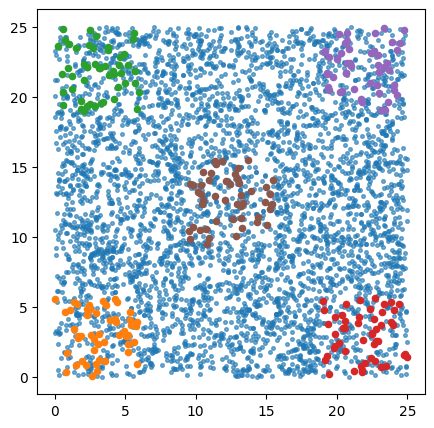

In [23]:
plot_locations(ts, sampled_spatial_samples[0], spatial_samples[0]["all"])

In [116]:
group_nodes = {
    k: np.vstack([ts.individual(i).nodes for i in v])
    for k, v in sampled_spatial_samples[0].items()
}

In [24]:
# pd.DataFrame({t: {k: len(v.flatten()) for k, v in group_nodes[i].items()} for i, t in enumerate(REL_SAMPLING_TIMES)})
pd.Series({k: len(v.flatten()) for k, v in group_nodes.items()})

NameError: name 'group_nodes' is not defined

In [124]:
group_indexes = list(product(range(len(group_nodes)), range(len(group_nodes))))

In [125]:
group_divergence = ts.divergence(
    [g.flatten() for g in group_nodes.values()],
    indexes=group_indexes,
).reshape(len(group_nodes), len(group_nodes))

In [126]:
pd.DataFrame(group_divergence, columns=group_nodes.keys(), index=group_nodes.keys())

,topleft,topright,bottomleft,bottomright,center
topleft,0.000104,0.000132,0.000134,0.000138,0.000131
topright,0.000132,0.000098,0.000140,0.000132,0.000130
bottomleft,0.000134,0.000140,0.000100,0.000133,0.000131
bottomright,0.000138,0.000132,0.000133,0.000101,0.000128
center,0.000131,0.000130,0.000131,0.000128,0.000119


In [129]:
pd.Series(
    ts.diversity([g.flatten() for g in group_nodes.values()]), index=group_nodes.keys()
)

topleft        0.000104
topright       0.000098
bottomleft     0.000100
bottomright    0.000101
center         0.000119
dtype: float64

In [131]:
pd.Series(
    ts.diversity([g.flatten() for g in group_nodes.values()], mode="branch"),
    index=group_nodes.keys(),
) * (MU / GT)

topleft        0.000104
topright       0.000097
bottomleft     0.000099
bottomright    0.000100
center         0.000119
dtype: float64

In [136]:
4 * len(pyslim.individuals_alive_at(ts, REL_SAMPLING_TIMES[0])) * MU

0.00017896

In [16]:
def get_geog_distance(ts, individual_pairs):
    a, b = ts.individuals_location[individual_pairs, 0:2].swapaxes(0, 1)
    return np.linalg.norm(a - b, axis=1)

In [412]:
ind_nodes = np.vstack(list(group_nodes.values()))
ind_groups = np.hstack([[k] * len(v) for k, v in group_nodes.items()])
ind_indexes = np.vstack(list(combinations_with_replacement(range(len(ind_nodes)), 2)))
group_pairs = list(combinations_with_replacement(group_nodes, 2))
ind_distance = get_geog_distance(
    ts, np.hstack(list(sampled_spatial_samples[0].values()))[ind_indexes]
)

In [141]:
ind_divergence = ts.divergence(ind_nodes, indexes=ind_indexes)

In [17]:
def get_breakpoints(arr1, arr2=None):
    breaks = np.zeros(len(arr1) - 1, dtype=bool)
    if arr2 is not None:
        assert len(arr1) == len(arr2)
        breaks[arr1[1:] != arr2[:-1]] = True
    else:
        breaks[arr1[1:] != arr1[:-1]] = True
    breaks = np.insert(breaks, 0, True)
    breaks = np.vstack(
        [np.where(breaks)[0], np.append(np.where(breaks)[0][1:], len(arr1))]
    ).T
    return [slice(*r) for r in breaks]

In [18]:
def plot_divergence(div, dist, indexes, groups, pairs):
    colors = np.zeros(len(indexes))
    assert len(div) == len(dist)
    mask = np.zeros_like(div, dtype=bool)
    for i, p in enumerate(pairs):
        assert (groups == p).all(1).sum() > 0, f"{p}"
        colors[(groups == p).all(1)] = i
        mask[(groups == p).all(1)] |= True
    scatter = plt.scatter(dist[mask], div[mask] * 1e3, c=colors[mask], alpha=0.3)

    plt.xlabel("geographic distance")
    plt.ylabel("genetic distance (diffs/Kb)")
    plt.legend(scatter.legend_elements()[0], pairs)

In [64]:
def plot_divergence_upper_tri(div, dist, ind_groups, groups):
    assert len(div) == len(dist)
    n_groups = len(groups)
    fig, axes = plt.subplots(
        n_groups,
        n_groups,
        figsize=(n_groups * 3, n_groups * 3),
        sharex=True,
        sharey=True,
    )
    for (i, g1), (j, g2) in combinations_with_replacement(enumerate(groups), 2):
        p = (g1, g2)
        axes[i, j].scatter(
            dist[(ind_groups == p).all(1)] * 1e3,
            div[(ind_groups == p).all(1)],
            alpha=0.3,
            s=4,
        )
        axes[i, j].set_title((g1, g2))
        if i != j:
            axes[j, i].scatter(
                dist[(ind_groups == p).all(1)] * 1e3,
                div[(ind_groups == p).all(1)],
                alpha=0.3,
                s=4,
            )
            axes[j, i].set_title((g2, g1))
    fig.supylabel("Genetic distance (diffs/Kb)")
    fig.supxlabel("Geographic distance")
    fig.tight_layout()

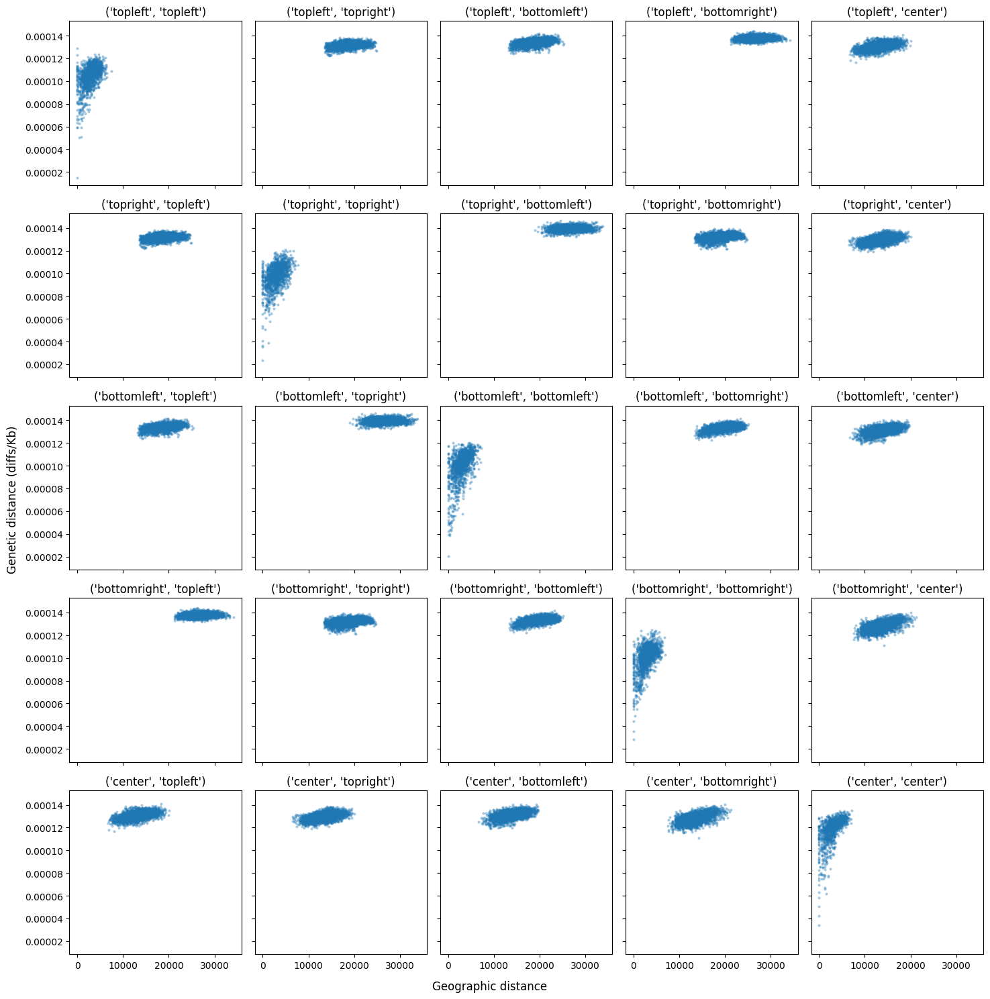

In [430]:
plot_divergence_upper_tri(
    ind_divergence, ind_distance, ind_groups[ind_indexes], list(group_nodes)
)

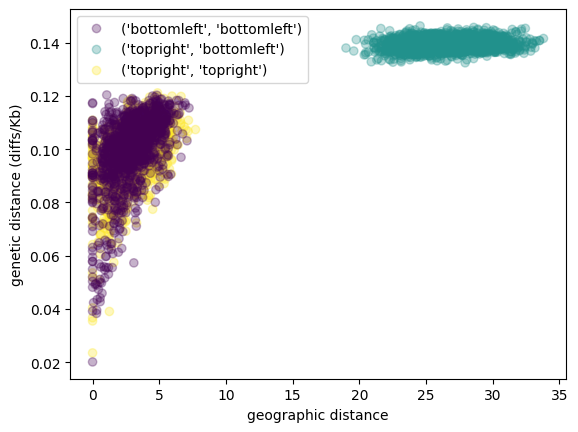

In [408]:
plot_divergence(
    ind_divergence,
    ind_distance,
    ind_indexes,
    ind_groups[ind_indexes],
    [
        ("bottomleft", "bottomleft"),
        ("topright", "bottomleft"),
        ("topright", "topright"),
    ],
)

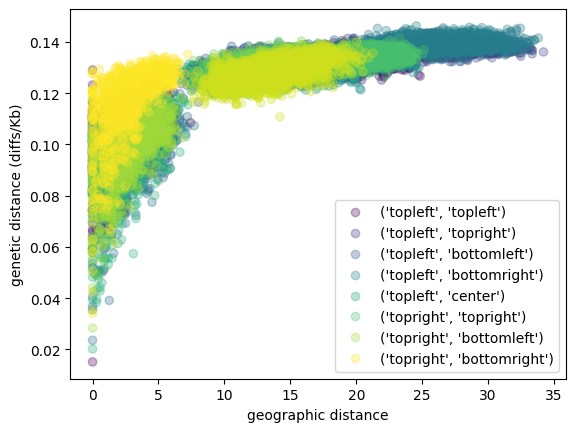

In [410]:
plot_divergence(
    ind_divergence, ind_distance, ind_indexes, ind_groups[ind_indexes], group_pairs
)

In [251]:
# for r in get_breakpoints(ind_groups[ind_indexes][:, 1], ind_groups[ind_indexes][:, 0])[0:6]:
#     print(ind_groups[ind_indexes][r])

In [252]:
# [s.stop - s.start for s in get_breakpoints(ind_groups[ind_indexes][:, 1] == ind_groups[ind_indexes][:, 0])]

In [253]:
# for r in get_breakpoints(ind_groups[ind_indexes][:, 1] == ind_groups[ind_indexes][:, 0])[0:6]:
#     print(ind_groups[ind_indexes][r])

In [20]:
def get_individuals_at_time_space_rings(ts, t, space_width, n_rings):
    alive = pyslim.individuals_alive_at(ts, t)
    n_alive = len(alive)
    locs = ts.individuals_location[alive, 0:2]
    bounds = np.linspace(0, space_width / 2, n_rings)
    lower_bounds = np.tile(bounds[:-1], n_alive).reshape(n_alive, len(bounds) - 1)
    upper_bounds = np.tile(bounds[1:], n_alive).reshape(n_alive, len(bounds) - 1)
    center = np.repeat(space_width / 2, np.prod(locs.shape)).reshape(*locs.shape)
    dist = np.linalg.norm(center - locs, axis=1)[:, np.newaxis]
    in_range = (lower_bounds <= dist) & (dist < upper_bounds)
    assert (in_range.sum(1) <= 1).all()
    return {
        "all": alive,
        **{str(b): alive[in_range[:, i]] for i, b in enumerate(bounds[1:])},
    }

In [21]:
rings = [
    get_individuals_at_time_space_rings(ts, t, MODEL_PARAMS["W"], 5)
    for t in REL_SAMPLING_TIMES
]

In [22]:
pd.DataFrame(
    {
        t: {k: len(v) for k, v in rings[i].items()}
        for i, t in enumerate(REL_SAMPLING_TIMES)
    }
)

,0,800,1600,2400,3200,4000,4800,5600,6400,7200,8000,8800,9600,10400,11200,12000,12800,13600,14400,15200
all,4474,4397,4511,4432,4478,4376,4578,4506,4509,4497,4582,4493,4511,4551,4539,4490,4450,4417,4517,4596
3.125,213,207,208,188,216,223,220,234,227,214,237,237,221,205,225,218,203,206,217,215
6.25,660,628,672,728,668,646,680,629,677,650,710,623,642,725,661,661,621,671,671,738
9.375,1097,1078,1073,1073,1098,1100,1163,1112,1159,1127,1114,1052,1124,1114,1066,1078,1115,1067,1205,1097
12.5,1598,1557,1571,1528,1588,1507,1567,1555,1491,1544,1587,1622,1645,1564,1594,1611,1569,1531,1467,1573


In [23]:
rings_sampled = [sample_individuals(s, 50, SEED) for s in rings]

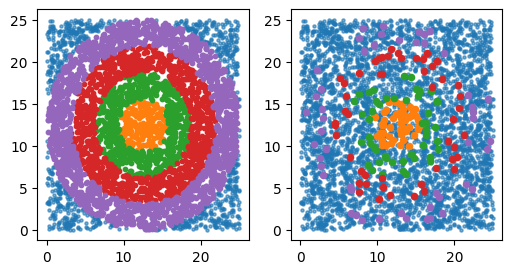

In [26]:
plt.subplots(1, 2, figsize=(6, 3))
plot_locations(
    ts, rings[0], rings[0]["all"], ax=plt.gcf().axes[0], sampled_s=10, all_s=5
)
plot_locations(
    ts, rings_sampled[0], rings[0]["all"], ax=plt.gcf().axes[1], sampled_s=20, all_s=5
)

In [66]:
from dataclasses import dataclass
from typing import Callable


@dataclass
class PairwiseStats:
    pair_func: Callable
    nodes: np.array
    samples: np.array
    pairs: np.array
    geog_distance: np.array
    divergence: np.array
    groups: list[str]
    ind_groups: np.array

    def __init__(
        self,
        ts: tskit.TreeSequence,
        grouped: dict[str, np.array],
        pair_func=lambda l: list(combinations_with_replacement(l, 2)),
    ):
        self.pair_func = pair_func
        self.nodes = np.vstack(
            [ts.individual(i).nodes for v in grouped.values() for i in v]
        )
        self.samples = np.hstack(list(grouped.values()))
        self.pairs = np.vstack(pair_func(range(len(self.samples))))
        self.geog_distance = get_geog_distance(ts, self.samples[self.pairs])
        self.divergence = ts.divergence(self.nodes, indexes=self.pairs)
        self.groups = list(grouped)
        self.ind_groups = np.hstack([[k] * len(v) for k, v in grouped.items()])

In [67]:
from joblib import Parallel, delayed

In [68]:
pstats = Parallel(verbose=10, n_jobs=15)(
    delayed(PairwiseStats)(ts, s) for s in rings_sampled
)

[Parallel(n_jobs=15)]: Using backend LokyBackend with 15 concurrent workers.
[Parallel(n_jobs=15)]: Done   3 out of  20 | elapsed:  3.6min remaining: 20.5min
[Parallel(n_jobs=15)]: Done   6 out of  20 | elapsed:  4.0min remaining:  9.2min
[Parallel(n_jobs=15)]: Done   9 out of  20 | elapsed:  4.3min remaining:  5.3min
[Parallel(n_jobs=15)]: Done  12 out of  20 | elapsed:  4.5min remaining:  3.0min
[Parallel(n_jobs=15)]: Done  15 out of  20 | elapsed:  5.0min remaining:  1.7min
[Parallel(n_jobs=15)]: Done  18 out of  20 | elapsed:  5.8min remaining:   38.8s
[Parallel(n_jobs=15)]: Done  20 out of  20 | elapsed:  6.0min finished


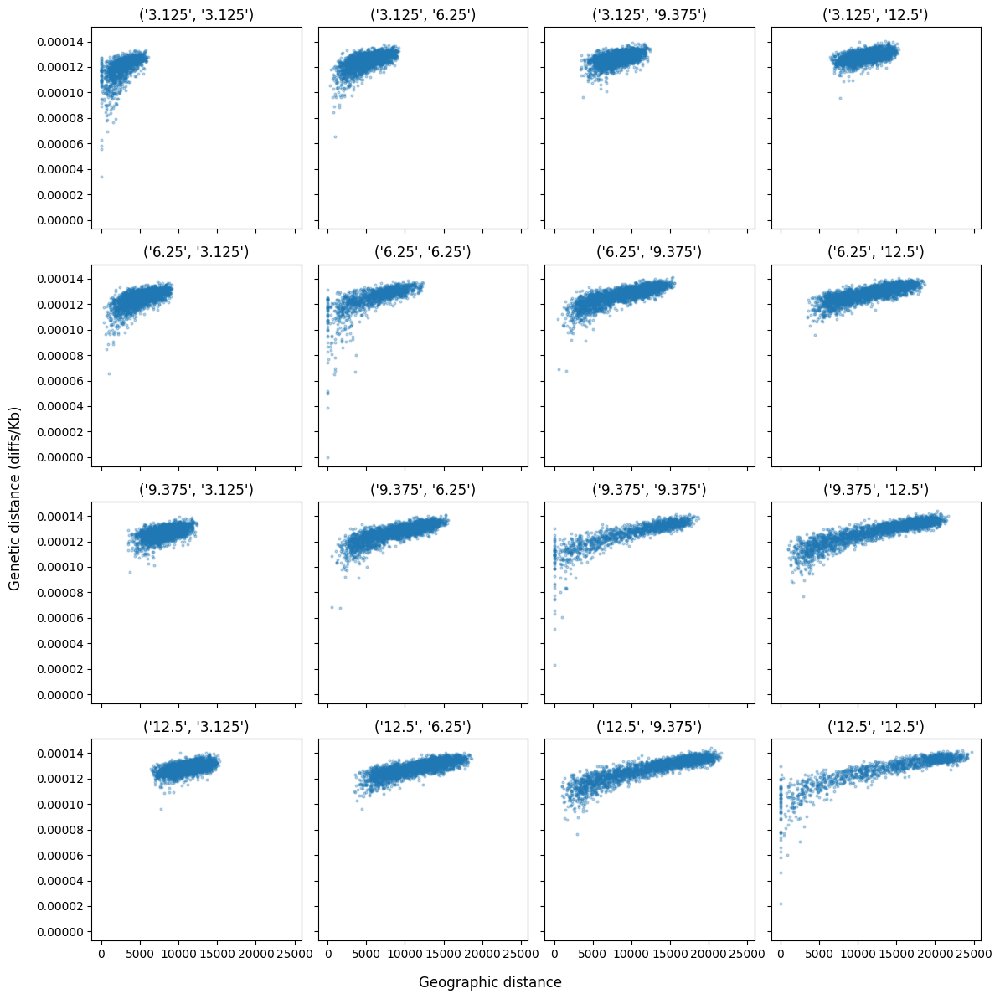

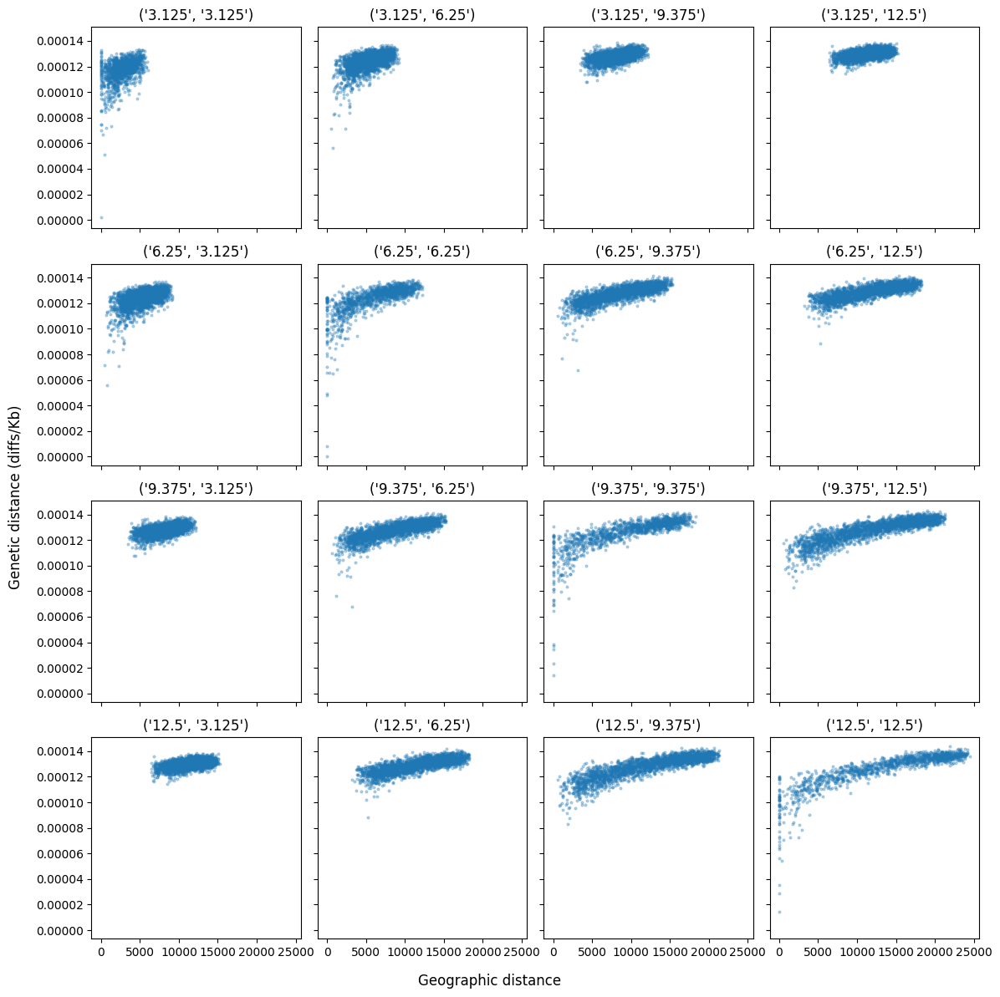

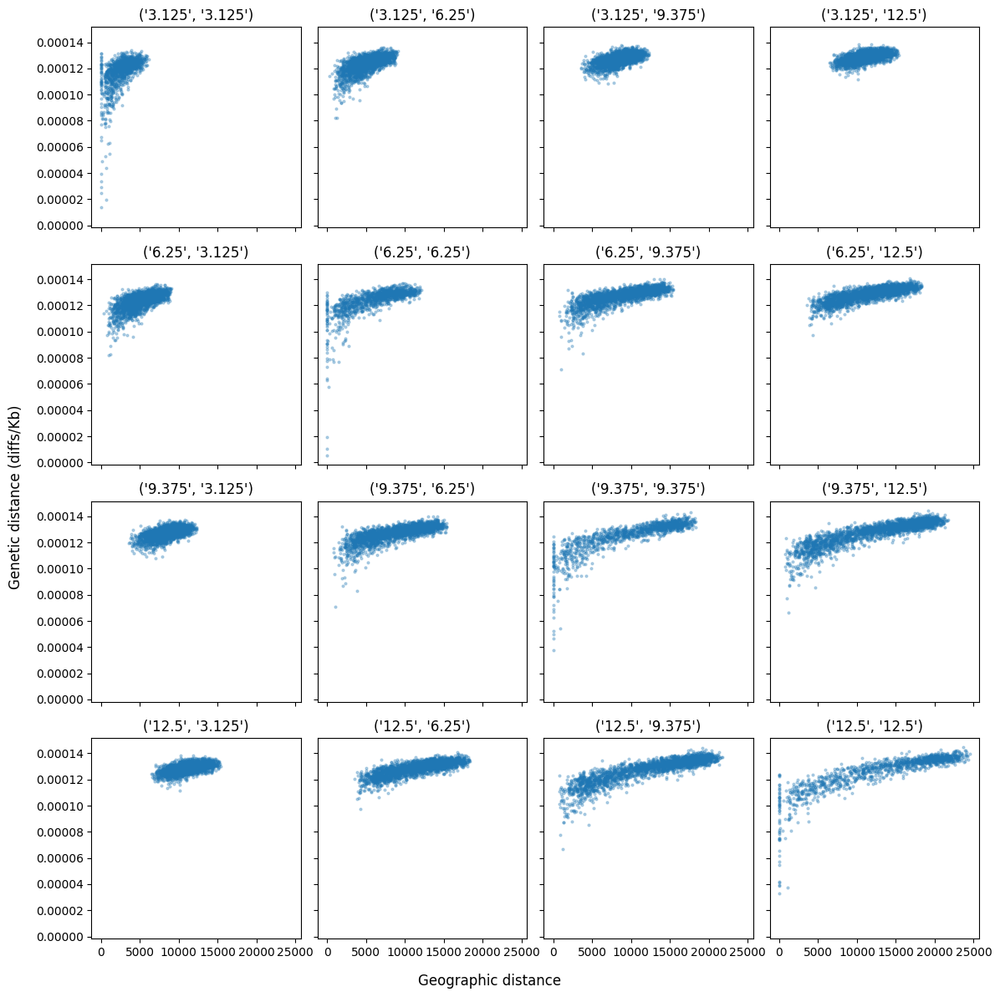

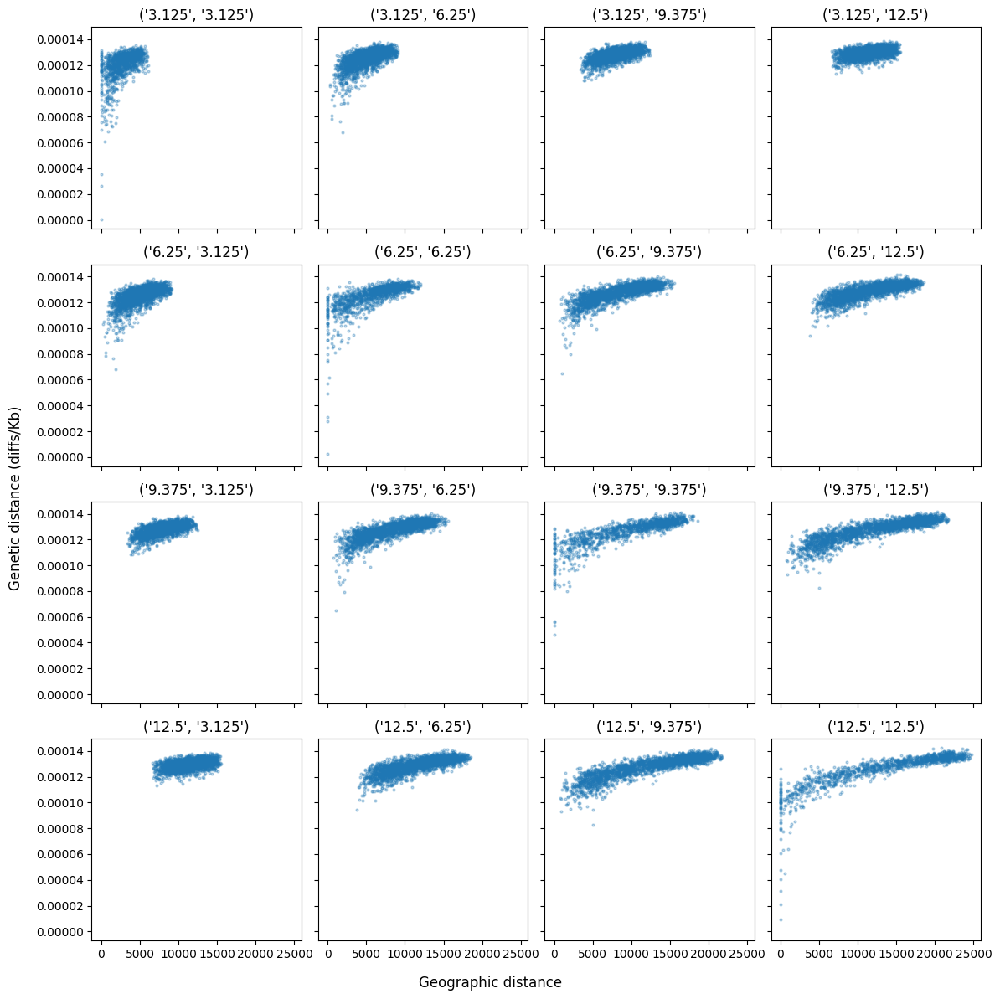

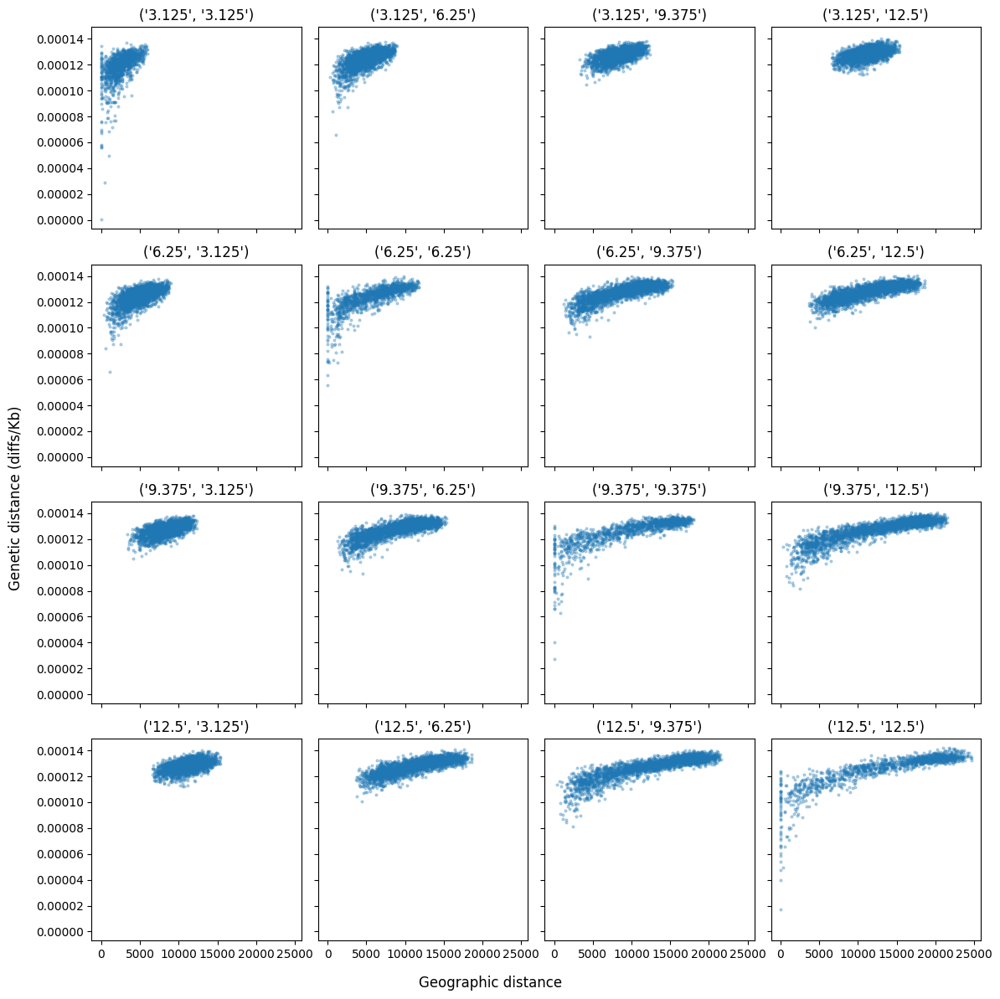

...

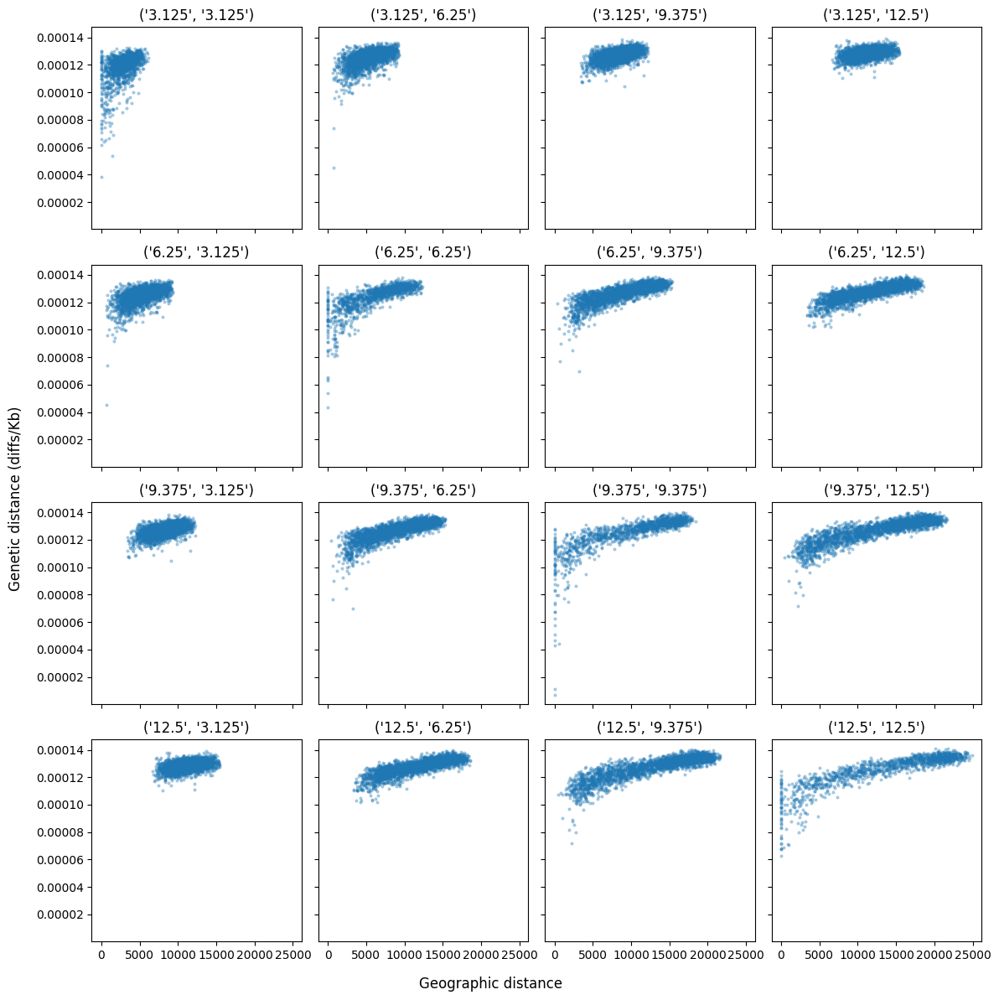

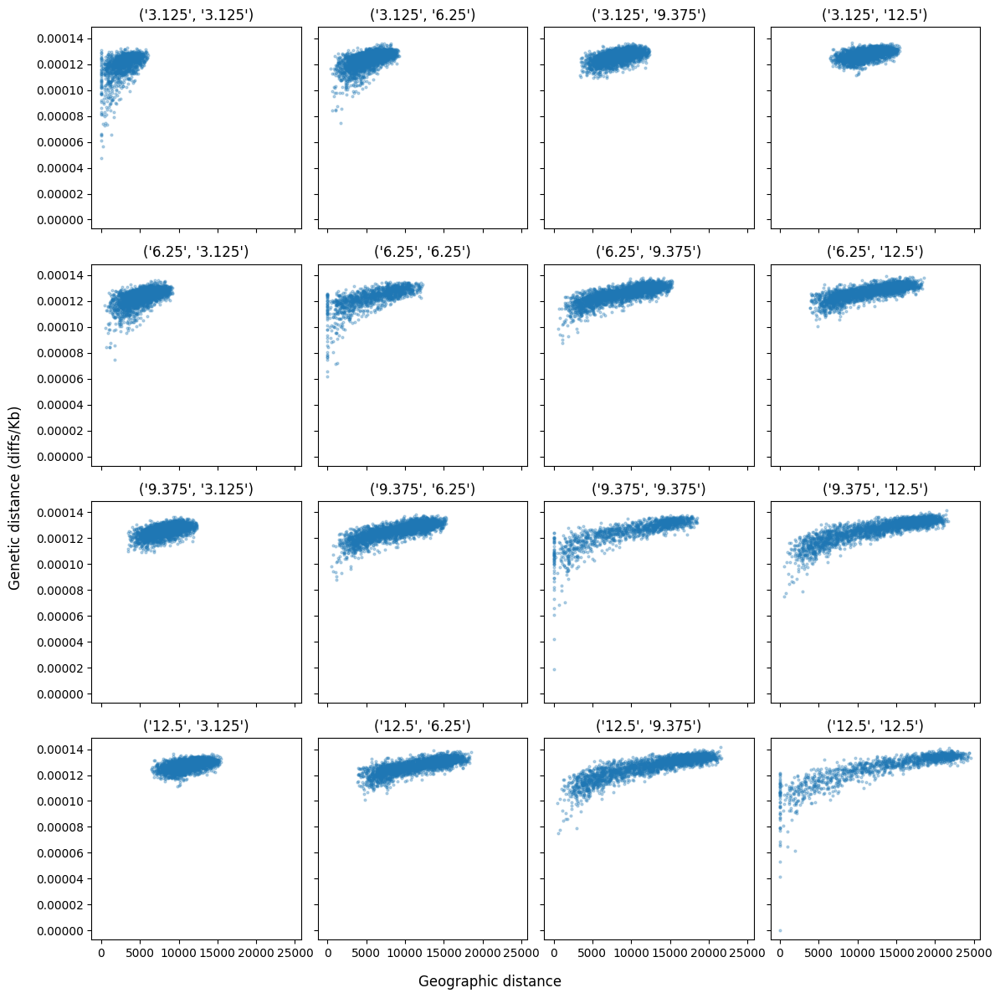

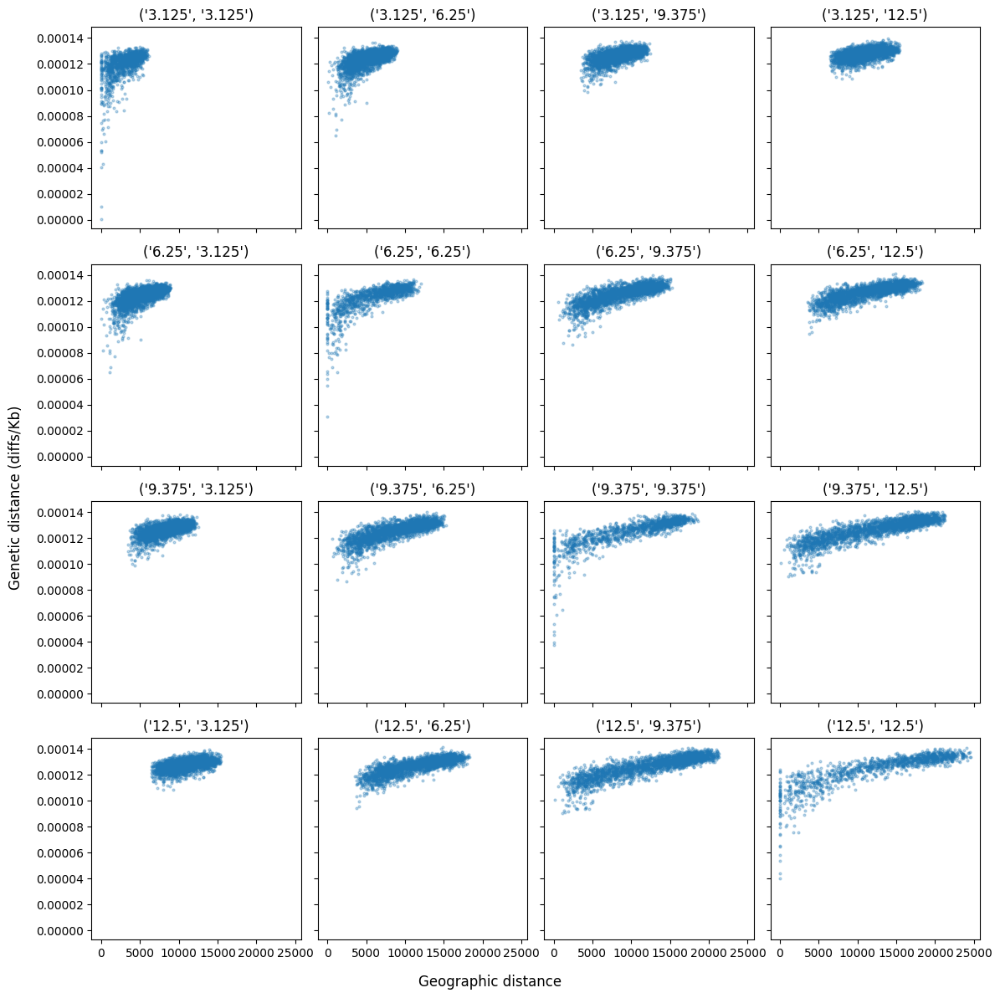

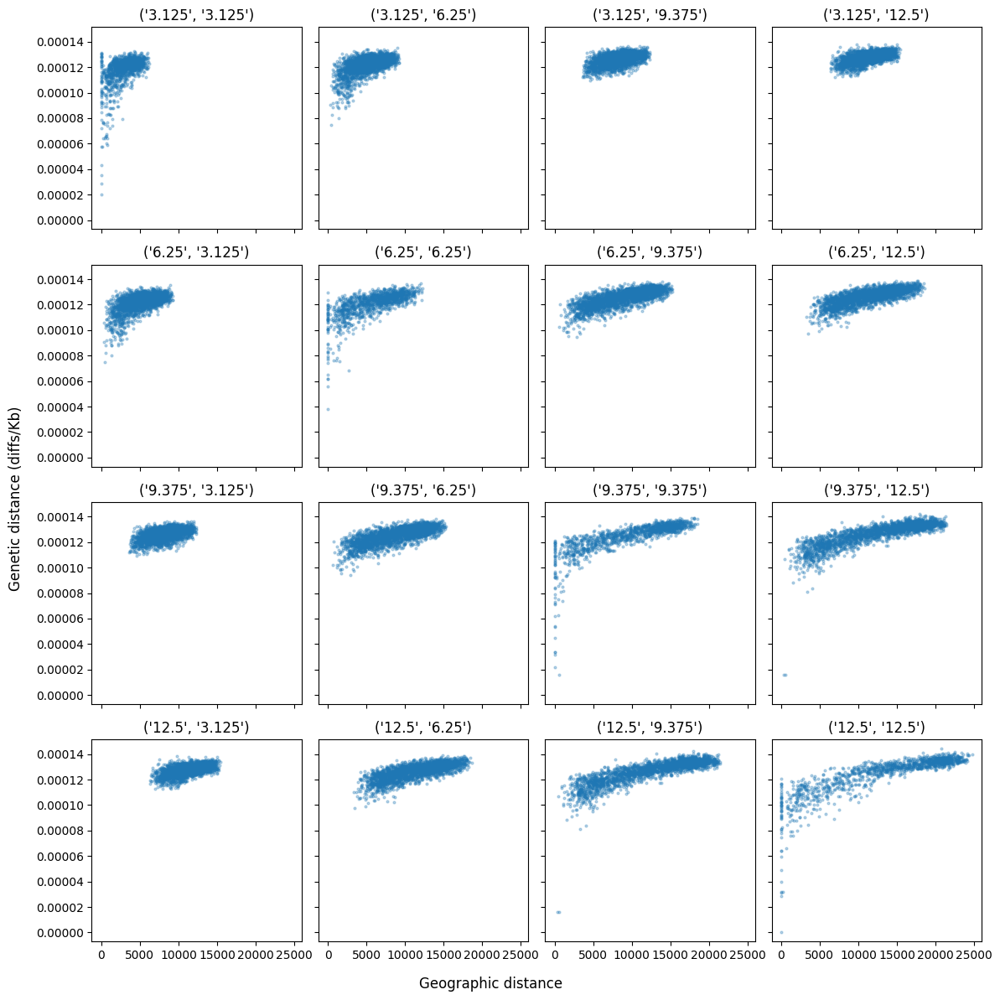

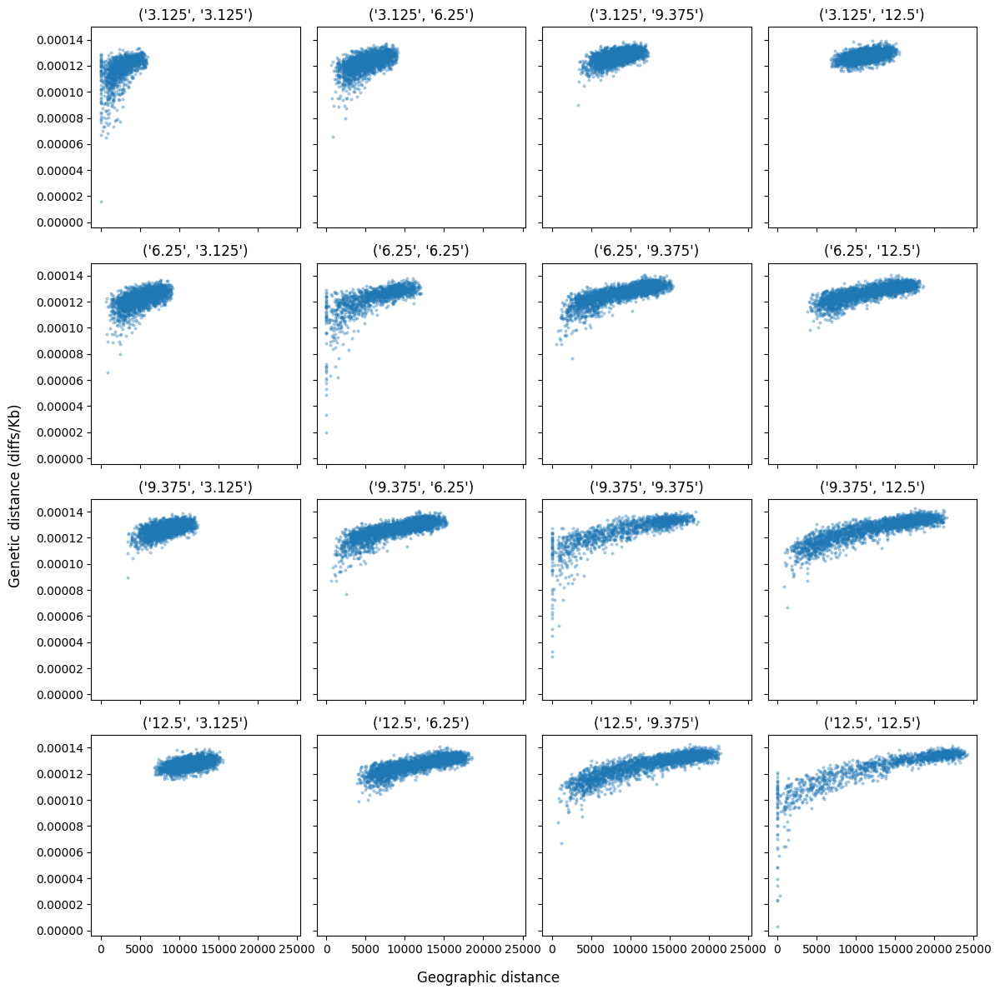

In [84]:
# plot_divergence_upper_tri(pstats[0].divergence, pstats[0].geog_distance, np.hstack([[k] * len(v) for k, v in rings_sampled[0].items()])[pstats[0].pairs], pstats[0].groups)
for p in pstats:
    plot_divergence_upper_tri(p.divergence, p.geog_distance, p.ind_groups[p.pairs], p.groups)
    plt.show()

In [72]:
[(pstats[0].groups[0], g) for g in pstats[0].groups[1:]]

[('3.125', '6.25'), ('3.125', '9.375'), ('3.125', '12.5')]

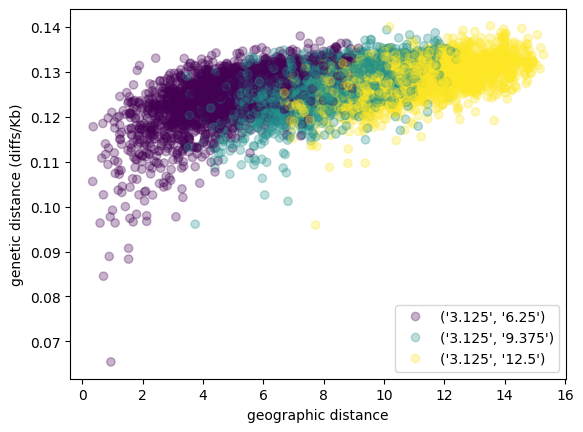

In [86]:
plot_divergence(
    pstats[0].divergence,
    pstats[0].geog_distance,
    pstats[0].pairs,
    pstats[0].ind_groups[pstats[0].pairs],
    [('3.125', '6.25'), ('3.125', '9.375'), ('3.125', '12.5')]
)